## Kulichenko Iana Panorama Stitching

# 1. Camera calibration

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

In [6]:
import glob
import os.path as osp
import cv2
import matplotlib
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
plt.rcParams['figure.figsize'] = (20.0, 16.0)
plt.rcParams['image.interpolation'] = 'bilinear'
plt.rcParams['image.cmap'] = 'gray'

list_paths = sorted(glob.glob('[0-9]*.jpg')) # create list of images paths
num_img = len(list_paths) # number of input images
num_img

33

In [7]:
list_paths

['1.jpg',
 '10.jpg',
 '11.jpg',
 '12.jpg',
 '13.jpg',
 '14.jpg',
 '15.jpg',
 '16.jpg',
 '17.jpg',
 '18.jpg',
 '19.jpg',
 '2.jpg',
 '20.jpg',
 '21.jpg',
 '22.jpg',
 '23.jpg',
 '24.jpg',
 '25.jpg',
 '26.jpg',
 '27.jpg',
 '28.jpg',
 '29.jpg',
 '3.jpg',
 '30.jpg',
 '31.jpg',
 '32.jpg',
 '33.jpg',
 '4.jpg',
 '5.jpg',
 '6.jpg',
 '7.jpg',
 '8.jpg',
 '9.jpg']

In [8]:
#load images
list_images = [plt.imread(path) for path in list_paths]

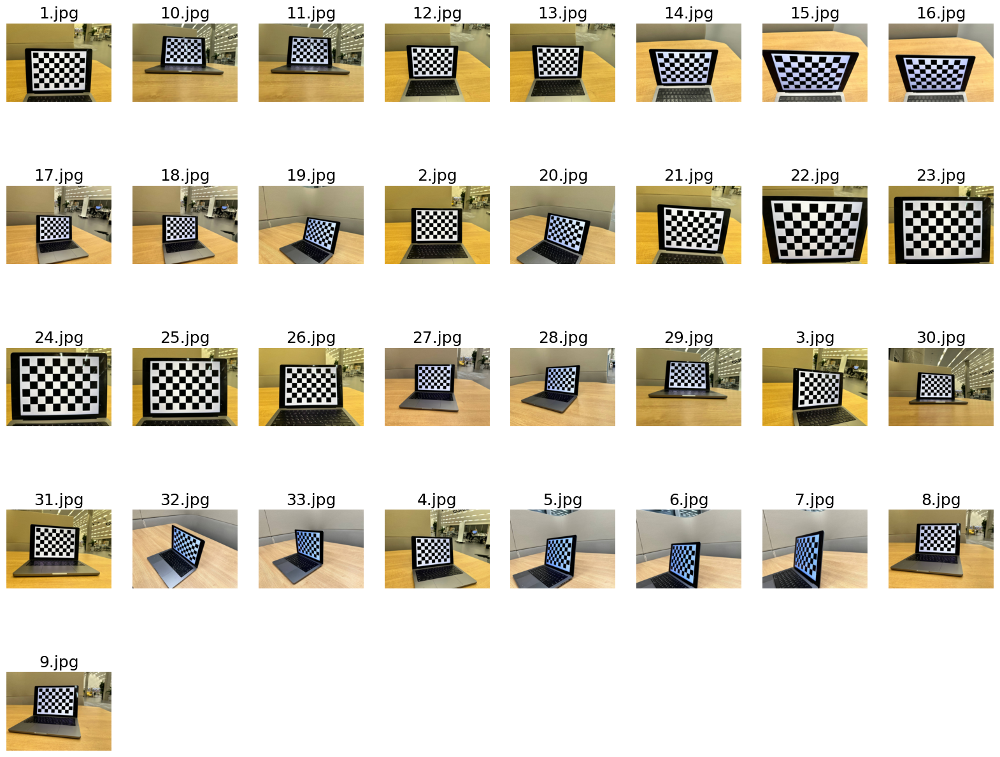

In [9]:
# draw all input images
images_list = [plt.imread(path) for path in list_paths]
fig=plt.figure(figsize=(20.0, 16.0))
for i, img in enumerate(images_list):
    ax=fig.add_subplot(5,8,i+1)
    plt.title(osp.basename(list_paths[i]), fontsize=18)
    plt.axis('off')
    plt.imshow(img) 

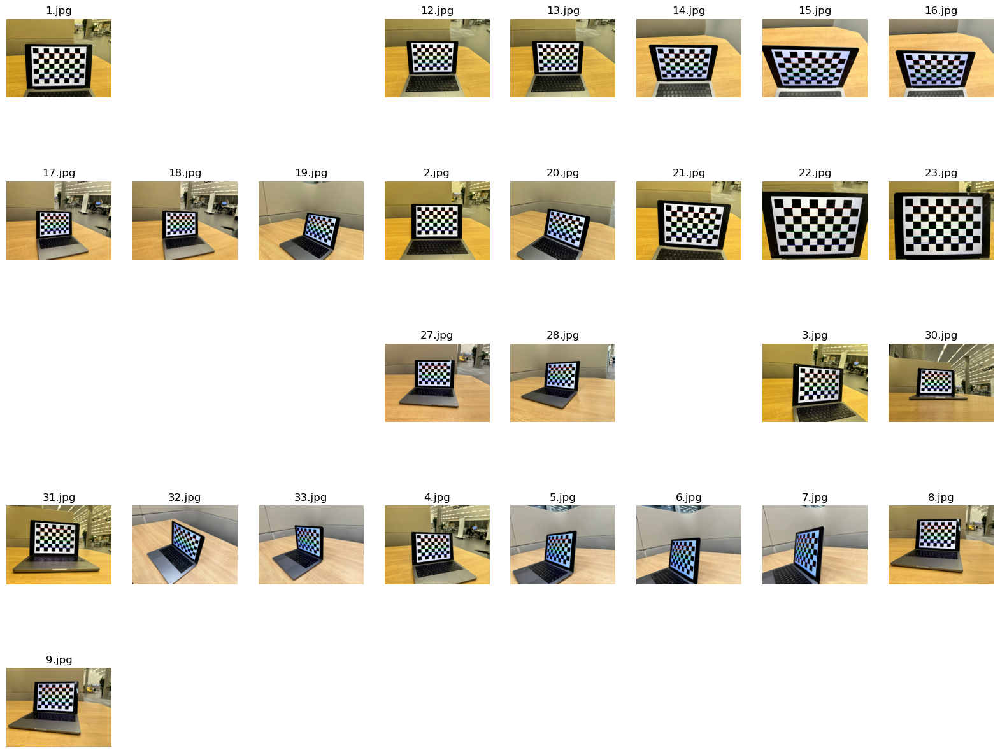

In [17]:
import cv2
import numpy as np
import glob
import math
# Chessboard parameters
chessboard_size = (9, 6)  # Number of inner corners on the board (width x height)
# Prepare 3D object points
objp = np.zeros((np.prod(chessboard_size), 3), dtype=np.float32)
objp[:, :2] = np.indices(chessboard_size).T.reshape(-1, 2)
# Lists to store 3D object points and 2D image points
object_points = []
image_points = []
list_of_image_files = sorted(glob.glob('[0-9]*.jpg'))
n_chessboard_imgs = len(list_of_image_files)
# Load and process each image
for i_num, image_file in enumerate(list_of_image_files):
    image = cv2.imread(image_file)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # Detect chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, chessboard_size, None)
    # If corners are found, add object and image points
    if ret:
        object_points.append(objp)
        image_points.append(corners)
        # Draw and display the corners
        image = cv2.drawChessboardCorners(image, chessboard_size, corners, ret)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        plt.subplot(math.ceil(n_chessboard_imgs / 8), 8, i_num + 1)
        plt.title(osp.basename(image_file), fontsize=12)
        plt.axis('off')
        plt.imshow(image)
plt.show()   



In [18]:
ret, K, dist, rvecs, tvecs = cv2.calibrateCamera(
    object_points, image_points, gray.shape[::-1], None, None
)
print("Calibration matrix K:\n", K)
print("Distortion:", dist.ravel())

Calibration matrix K:
 [[903.39623463   0.         642.50951446]
 [  0.         903.14566815 479.91596955]
 [  0.           0.           1.        ]]
Distortion: [ 1.72917094e-01 -4.57299546e-01  9.67318165e-04  2.94448734e-04
 -1.19974681e-01]


In [19]:
img = cv2.imread("1.jpg")
h,  w = img.shape[:2]
newcameramtx, roi = cv2.getOptimalNewCameraMatrix(K, dist, (w,h), 1, (w,h))
newcameramtx, roi

(array([[483.02240053,   0.        , 760.11002403],
        [  0.        , 582.07145856, 503.66210082],
        [  0.        ,   0.        ,   1.        ]]),
 (417, 197, 684, 612))

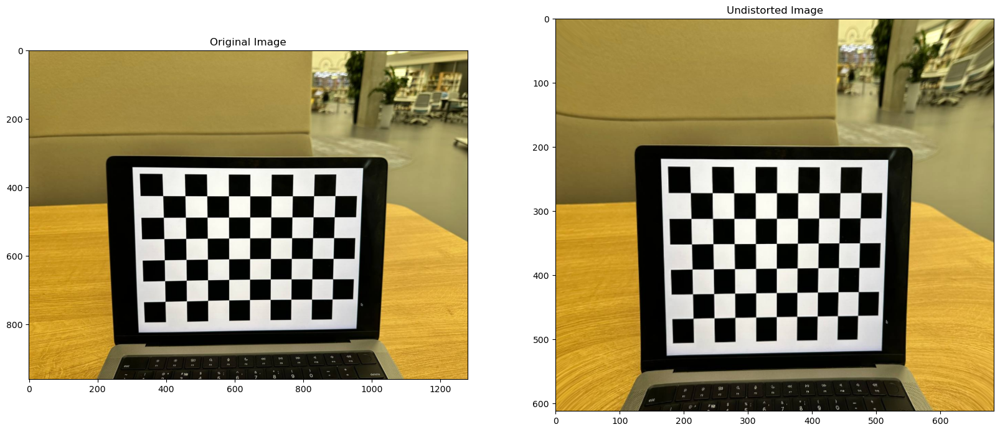

In [20]:
# Load an image for testing
img = cv2.imread("1.jpg")  

# Undistort the image
undistorted_img = cv2.undistort(
    src=img,
    cameraMatrix=K,
    distCoeffs=dist,
    dst=None,
    newCameraMatrix=newcameramtx
    )

# cropping images to the ROI size
x, y, w, h = roi
undistorted_img = undistorted_img[y:y+h, x:x+w]


# Display the original and undistorted images using plt.imshow
plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title("Original Image")

plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(undistorted_img, cv2.COLOR_BGR2RGB))
plt.title("Undistorted Image")

plt.show()

In [22]:
# # undistort
# mapx, mapy = cv2.initUndistortRectifyMap(K, dist, None, newcameramtx, (w,h), 5)
# dst = cv2.remap(img, mapx, mapy, cv2.INTER_LINEAR)
# # crop the image
# x, y, w, h = roi
# dst = dst[y:y+h, x:x+w]

# # Display the original and undistorted images using plt.imshow
# plt.subplot(1, 2, 1)
# plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
# plt.title("Original Image")

# plt.subplot(1, 2, 2)
# plt.imshow(cv2.cvtColor(dst, cv2.COLOR_BGR2RGB))
# plt.title("Undistorted Image")

# plt.show()

## Images for panorama

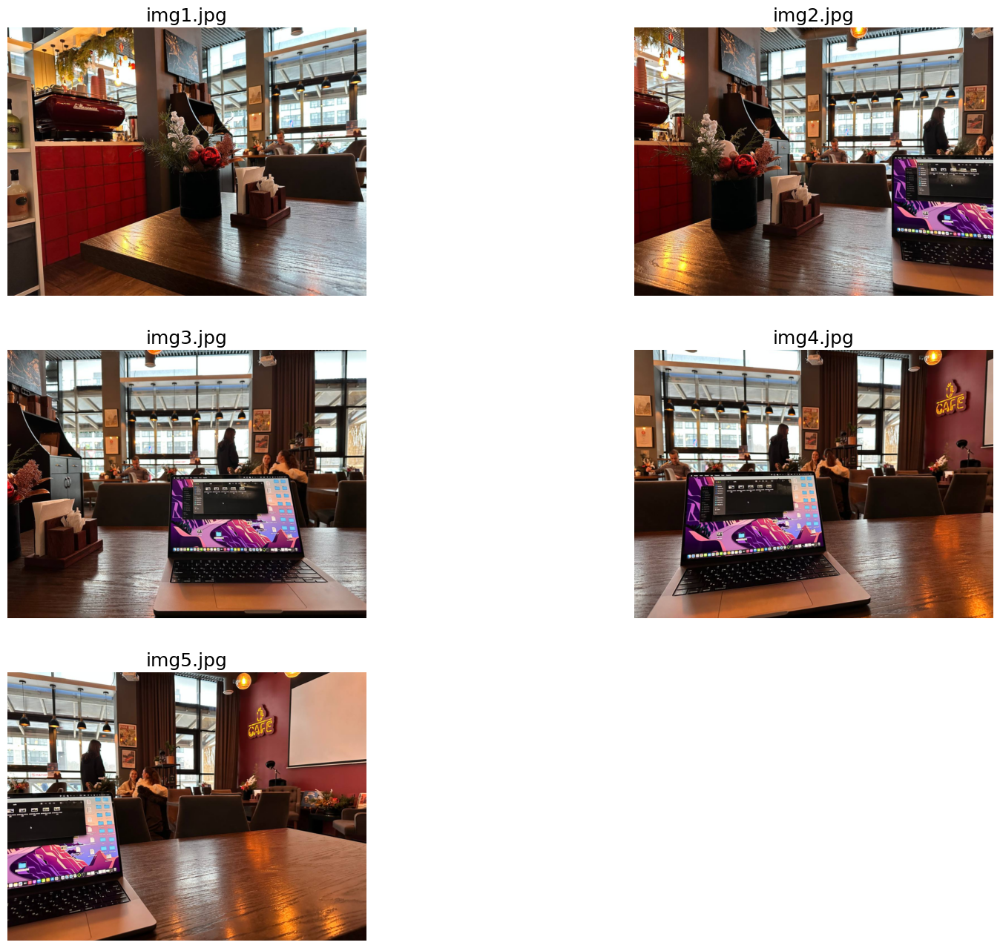

In [31]:
list_paths = sorted(glob.glob('img*.jpg')) # create list of images paths
num_img = len(list_paths) # number of input images
images = [plt.imread(path) for path in list_paths]
fig=plt.figure(figsize=(20.0, 16.0))

for i, img in enumerate(images):
    ax=fig.add_subplot(3,2,i+1)
    plt.title(osp.basename(list_paths[i]), fontsize=18)
    plt.axis('off')
    plt.imshow(img) 

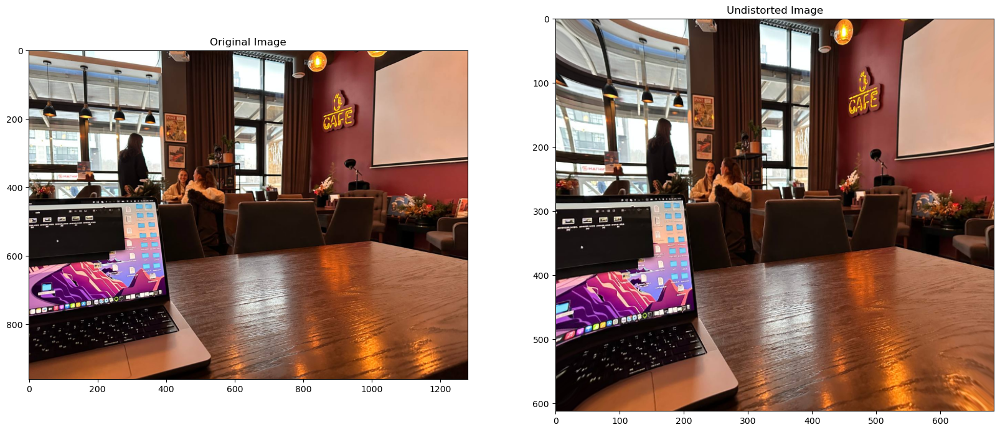

In [32]:
images = [plt.imread(path) for path in list_paths]
for i, image in enumerate(list_paths):
    # Load an image for testing
    img = cv2.imread(image)  

    # Undistort the image
    undistorted_img = cv2.undistort(
        src=img,
        cameraMatrix=K,
        distCoeffs=dist,
        dst=None,
        newCameraMatrix=newcameramtx
        )
    
    # cropping images to the ROI size
    x, y, w, h = roi
    undistorted_img = undistorted_img[y:y+h, x:x+w]
    images[i] = cv2.cvtColor(undistorted_img, cv2.COLOR_BGR2RGB)
    
    # Display the original and undistorted images using plt.imshow
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title("Original Image")
    
    
    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(undistorted_img, cv2.COLOR_BGR2RGB))
    plt.title("Undistorted Image")


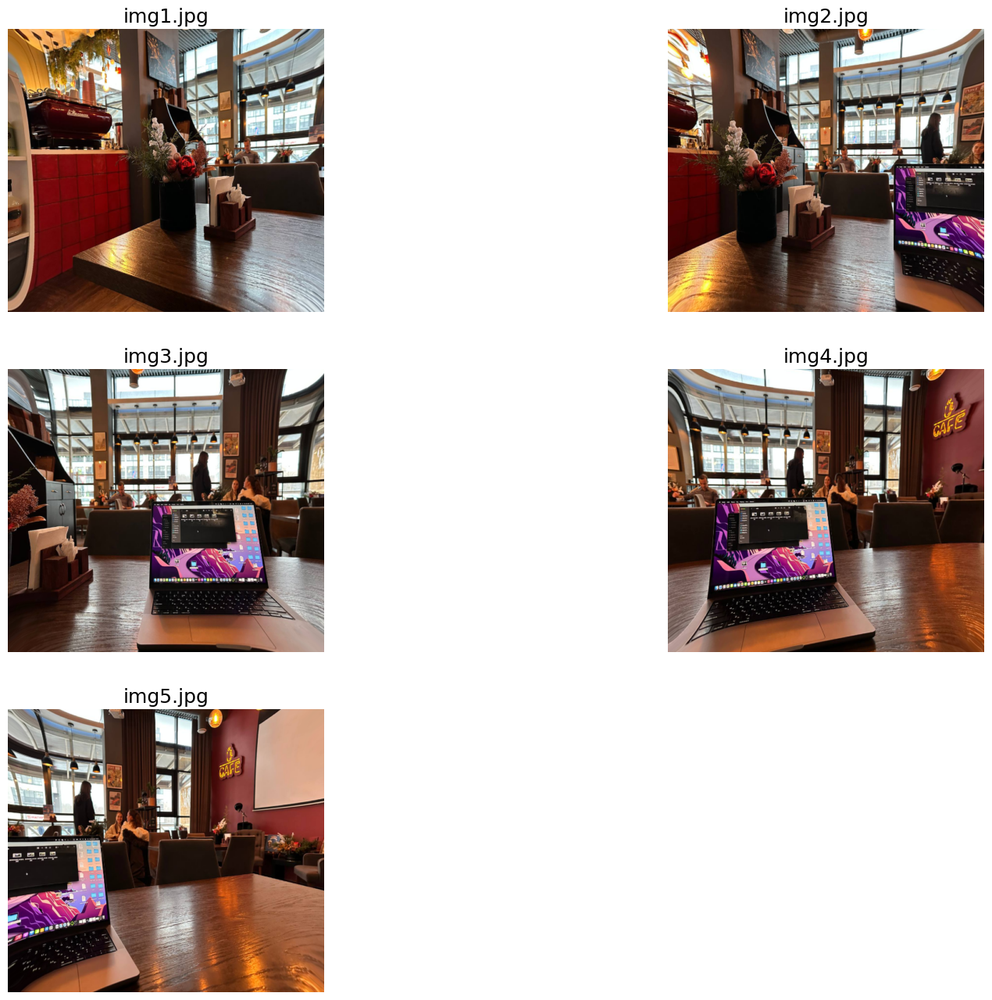

In [33]:
fig=plt.figure(figsize=(20.0, 16.0))
for i, img in enumerate(images):
    ax=fig.add_subplot(3,2,i+1)
    plt.title(osp.basename(list_paths[i]), fontsize=18)
    plt.axis('off')
    plt.imshow(img) 

# 2. SIFT, ORB

 ## SIFT (Scale-Invariant Feature Transform) is a feature extraction algorithm widely used in computer vision for its robustness to changes in scale, rotation, and illumination. SIFT identifies keypoints by detecting local extrema in the scale-space representation of an image and assigns them consistent orientations for rotation invariance. Descriptors are constructed based on gradient orientations in local neighborhoods, making SIFT well-suited for tasks like image matching and object recognition.

 ## The Oriented FAST and Rotated BRIEF (ORB) algorithm is a feature detection and description technique in computer vision. Introduced as an efficient alternative to algorithms like SIFT and SURF, ORB combines the speed of the FAST keypoint detector with the simplicity and robustness of the BRIEF descriptor. ORB identifies keypoints by detecting corners through FAST, generates binary descriptors using BRIEF, and introduces rotation invariance by computing the orientation of keypoints. It offers a balance between computational efficiency and performance, making it suitable for real-time applications. 

In [151]:
paths = sorted(glob.glob('img*.jpg'))
list_images = [plt.imread(path) for path in paths]

In [136]:
def findAndDescribeFeatures(image, param="SIFT"):
    """ 'SIFT' - SIFT algorithm
        'ORB' - ORB algorithm"""
    
    # gray image
    grayImage = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    if param == "SIFT":
        md = cv2.SIFT_create()
    if param == "ORB":
        md = cv2.ORB_create()
    
    # Find  keypoints and descriptors
    keypoints, descriptors = md.detectAndCompute(grayImage, None)
    return keypoints, descriptors

## SIFT(Scale-Invariant Feature Transform) 

In [152]:
#extract keypoints and descriptors using sift
k0,f0=findAndDescribeFeatures(list_images[0], param = 'SIFT')
k1,f1=findAndDescribeFeatures(list_images[1], param = 'SIFT')

In [153]:
def drawKeypoints(image, kps):
    img1 = image
    cv2.drawKeypoints(image, kps, img1, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    return img1

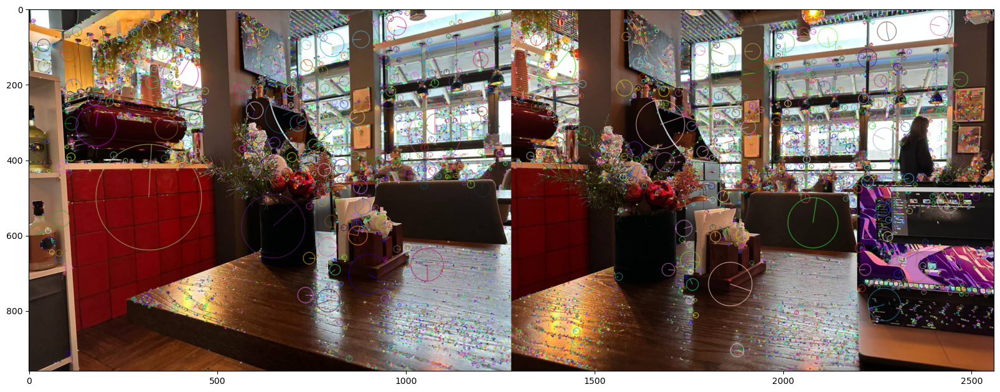

In [154]:
#draw keypoints
img0_kp=drawKeypoints(list_images[0].copy(),k0)
img1_kp=drawKeypoints(list_images[1].copy(),k1)

fig=plt.figure(figsize=(20.0, 16.0))
plt_img = np.concatenate((img0_kp, img1_kp), axis=1)
plt.imshow(plt_img)

In [155]:
def keypoints_matching(desc1, desc2, param = "FL", param_2 = "SIFT", ratio=0.6):
    """matching features beetween 2 @features.
         If opt='FB', FlannBased algorithm is used.
         If opt='BF', BruteForce algorithm is used.
         ratio is the Lowe's ratio test"""
    if param == "BF":
        matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
        
    if param == "FL":
        if param_2 == "SIFT":
            index_params = dict(algorithm=1, trees=5)
            search_params = dict(checks=50)
        elif param_2 == "ORB":
            index_params = dict(algorithm=6, table_number=6, key_size=12, multi_probe_level=1)
            search_params = dict(checks=50)

        matcher = cv2.FlannBasedMatcher(index_params, search_params)
        
    # KNN matching(2 feature vectors)
    # k=2 - top 2 matches for each vector 
    matches = matcher.knnMatch(desc1, desc2, k=2)

    # find good matches 
    good_matches = []
    for match in matches:
        if len(match) == 2 and match[0].distance < ratio * match[1].distance:
            good_matches.append(match[0])
            
    if len(good_matches) > 4:
        return good_matches
    raise Exception("Few matches")

In [156]:
def homography_matrix(input_image, final_image, param_2 = "SIFT", ransac_rep = 5.0):
    """ input_image - image which is warped by homography,
        final_image - image which is choosing as pivot,
        ransac_rep - max pixel allowed by the RANSAC algorithm"""

    input_kp, input_desc = findAndDescribeFeatures(input_image, param_2)
    final_kp, final_desc = findAndDescribeFeatures(final_image, param_2)
    good = keypoints_matching(input_desc, final_desc, param_2=param_2)

    input_points = np.float32([input_kp[m.queryIdx].pt for m in good]).reshape(-1, 1, 2)
    final_points = np.float32([final_kp[m.trainIdx].pt for m in good]).reshape(-1, 1, 2)
    H, mask = cv2.findHomography(input_points, final_points, cv2.RANSAC, ransac_rep)
    matchesMask = mask.ravel().tolist()
    return H, matchesMask

In [157]:
#matching FLANN
mat = keypoints_matching(f0,f1,param='FL',param_2='SIFT',ratio=0.75)

In [158]:
#find homography matrix and mask
H, mat_mask = homography_matrix(list_images[0],list_images[1],param_2='SIFT')

In [159]:
len(mat)

1027

In [160]:
len(mat_mask)

676

In [161]:
def draw_matches(input_image, input_keypoints, final_image, final_keypoints, matches, matchesMask):
    return cv2.drawMatches(input_image, 
                           input_keypoints, 
                           final_image, 
                           final_keypoints, 
                           matches[:100], 
                           None, 
                           matchColor=(0, 255, 0), #green color
                           singlePointColor=None,
                           matchesMask=matchesMask[:100], #draw only the first 100 matches
                           flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
                        )

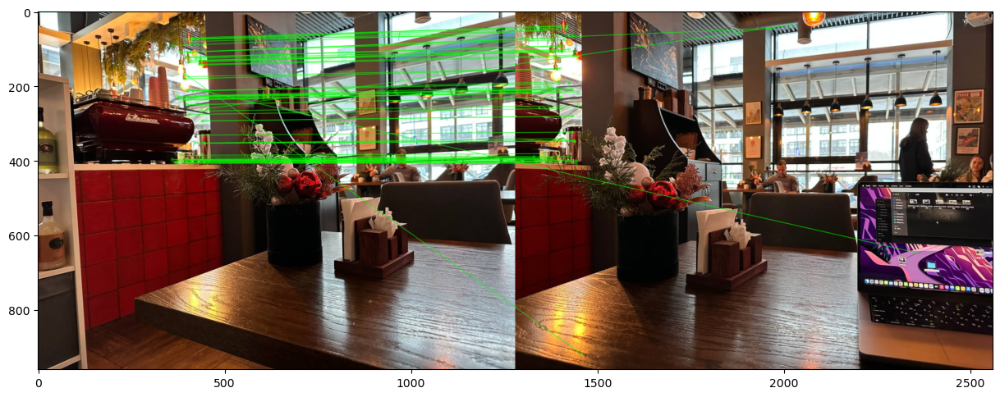

In [162]:
# Draw Matches
img=draw_matches(list_images[0],k0,list_images[1],k1,mat,mat_mask)
plt.figure(figsize=(15,15))
plt.imshow(img)

In [163]:
def crop_image(img_panorama, height, angles):
    """img_panorama - image of panorama
       height - height of final image
       angles - tuple of 4 angles of warped image and
       4 angles of final image"""
    # max min of coordinates
    [xmin, ymin] = np.int16(angles.min(axis=0).ravel() - 0.5)
    t = [-xmin, -ymin]
    angles = angles.astype(int)
    # angles[0][0][0] - x top left point(warped image)
    # If angles[0][0][0] < 0, warp image is merged to the left side of final image
    # else it merged to the right side of final
    if angles[0][0][0] < 0:
        n = abs(-angles[1][0][0] + angles[0][0][0])
        img_panorama = img_panorama[t[1] : height + t[1], n:, :]
    else:
        if angles[2][0][0] < angles[3][0][0]:
            img_panorama = img_panorama[t[1] : height + t[1], 0 : angles[2][0][0], :]
        else:
            img_panorama = img_panorama[t[1] : height + t[1], 0 : angles[3][0][0], :]
    return img_panorama

In [164]:
def warp_2_images(input_image, final_image,param_2 = "SIFT", showstep=False):
    
    # generate Homography matrix
    H, mask = homography_matrix(input_image, final_image,param_2 = param_2)
    #height and width images
    h_input, w_input = input_image.shape[:2]
    h_final, w_final = final_image.shape[:2]
    # get 4 angles of images (top left, bottom left, bottom right, top right)
    ang_1 = np.float32([[0, 0], [0, h_input], [w_input, h_input], [w_input, 0]]).reshape(-1, 1, 2)
    ang_2 = np.float32([[0, 0], [0, h_final], [w_final, h_final], [w_final, 0]]).reshape(-1, 1, 2)
    try:
        # apply homography to angles of src image
        ang_1_T = cv2.perspectiveTransform(ang_1, H)
        ang = np.concatenate((ang_1_T, ang_2), axis=0)
        # min max of coordinates
        [xmin, ymin] = np.int64(ang.min(axis=0).ravel() - 0.5)
        [mask_, ymax] = np.int64(ang.max(axis=0).ravel() + 0.5)
        t = [-xmin, -ymin]

        # if top left point of image has x < 0 => side=left, else => side=right
        # compute final image width, height
        if ang[0][0][0] < 0:
            side = "left"
            width_panorama = w_final + t[0]
        else:
            width_panorama = int(ang_1_T[3][0][0])
            side = "right"
        height_panorama = ymax - ymin

        Ht = np.array([[1, 0, t[0]], [0, 1, t[1]], [0, 0, 1]])
        input_image_warped = cv2.warpPerspective(input_image, Ht.dot(H), (width_panorama, height_panorama))
        #final merge to l/r side
        final_image_join = np.zeros((height_panorama, width_panorama, 3))
        if side == "left":
            final_image_join[t[1] : h_input + t[1], t[0] : w_final + t[0]] = final_image
        else:
            final_image_join[t[1] : h_input + t[1], :w_final] = final_image
            
        # blending final image
        panorama, nonblend, leftside, rightside = panoramaBlending(
            final_image_join, input_image_warped, w_final, side, showstep=showstep
        )

        # croping black region
        panorama = crop_image(panorama, h_final, ang)
        
        return panorama, nonblend, leftside, rightside
    
    except BaseException:
        raise Exception("Error, try with another images ")


In [165]:
def create_blending_mask(image_height, image_width, blending_barrier, smoothing_window, left_to_right=True):
    # Ensure the blending barrier is within the width of the image
    assert blending_barrier < image_width
    
    # Initialize a mask with zeros
    blending_mask = np.zeros((image_height, image_width))

    # Calculate the offset for the smoothing window
    window_offset = int(smoothing_window / 2)

    # Generate a set of weights based on the smoothing window and direction
    weights = np.linspace(1, 0, 2 * window_offset + 1) if left_to_right else np.linspace(0, 1, 2 * window_offset + 1)

    try:
        # Apply weights to the central region of the mask
        blending_mask[:, blending_barrier - window_offset : blending_barrier + window_offset + 1] = np.tile(weights.T, (image_height, 1))
        
        # Set the left side of the mask to 1 if left_to_right is True, else set it to 0
        blending_mask[:, : blending_barrier - window_offset] = 1 if left_to_right else 0
        
        # Set the right side of the mask to 0 if left_to_right is True, else set it to 1
        blending_mask[:, blending_barrier + window_offset :] = 0 if left_to_right else 1
    except BaseException:
        # Exception handling for edge cases (e.g., when window_offset is 0)
        # Apply weights to the central region of the mask
        blending_mask[:, blending_barrier - window_offset : blending_barrier + window_offset + 1] = np.tile(weights[:-1].T, (image_height, 1))
        
        # Set the left side of the mask to 1 if left_to_right is True, else set it to 0
        blending_mask[:, : blending_barrier - window_offset] = 1 if left_to_right else 0
        
        # Set the right side of the mask to 0 if left_to_right is True, else set it to 1
        blending_mask[:, blending_barrier + window_offset :] = 0 if left_to_right else 1

    # Convert the mask to a 3-channel image (BGR)
    return cv2.merge([blending_mask, blending_mask, blending_mask])


In [166]:
def panoramaBlending(final_image_join, input_image_warped, w_final, side, showstep=False):
    """
    This function smooths the transition between aligned images,
    final_image_join (final joined image) and input_image_warped (warped input image).

    Parameters:
    - final_image_join: The final joined image.
    - input_image_warped: The warped input image.
    - w_final: The width of the final image before resizing.
    - side: Flag that determines whether to mask the left image or the right.
    """

    # Get the dimensions of the final joined image
    h, w, _ = final_image_join.shape

    # Define the smoothing window and barrier based on the width of the final image
    smoothing_window = int(w_final / 8)
    barrier = w_final - int(smoothing_window / 2)

    # Create blending masks for the left and right sides
    mask1 = create_blending_mask(
        h, w, barrier, smoothing_window=smoothing_window, left_to_right=True
    )
    mask2 = create_blending_mask(
        h, w, barrier, smoothing_window=smoothing_window, left_to_right=False
    )

    # Create a non-blended version by adding the input and final images
    nonblend = input_image_warped + final_image_join

    # Initialize variables for the left and right sides (for visualization)
    leftside = None
    rightside = None

    # Check the specified side for blending
    if side == "left":
        # Flip images horizontally for left side blending
        final_image_join = cv2.flip(final_image_join, 1)
        input_image_warped = cv2.flip(input_image_warped, 1)

        # Apply blending masks to the flipped images
        final_image_join = final_image_join * mask1
        input_image_warped = input_image_warped * mask2

        # Combine images and flip the result back
        pano = input_image_warped + final_image_join
        pano = cv2.flip(pano, 1)

        # If showstep is True, prepare left and right sides for visualization
        if showstep:
            leftside = cv2.flip(input_image_warped, 1)
            rightside = cv2.flip(final_image_join, 1)
    else:
        # Apply blending masks to the images
        final_image_join = final_image_join * mask1
        input_image_warped = input_image_warped * mask2

        # Combine images
        pano = input_image_warped + final_image_join

        # If showstep is True, prepare left and right sides for visualization
        if showstep:
            leftside = final_image_join
            rightside = input_image_warped

    return pano, nonblend, leftside, rightside


In [167]:
#wrap 2 image
#choose list_images[0] as desination
panorama,non_blend,left_side,right_side=warp_2_images(list_images[1],list_images[0],"SIFT",True)

In [168]:
def convert_img(img):
    '''reduce the range of floating point image ( [0,255] to [0,1] )'''
    img = np.array(img,dtype=float)/float(255)
    return img

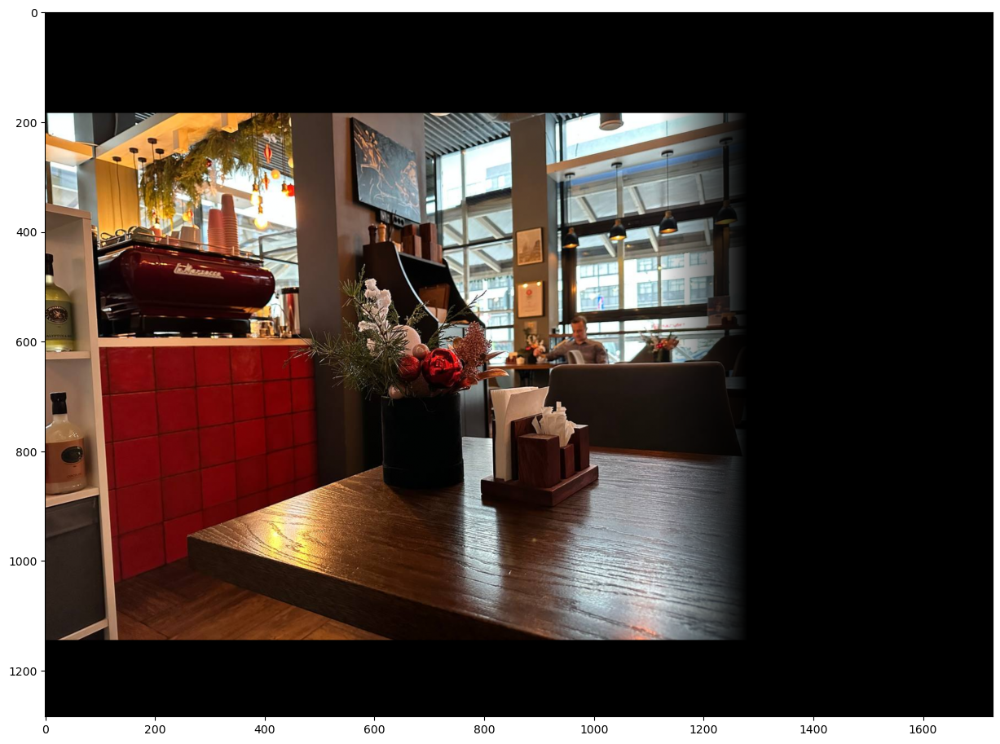

In [169]:
#display the leftside of pano before cropping
plt.figure(figsize=(15,15))
plt.imshow(convert_img(left_side))

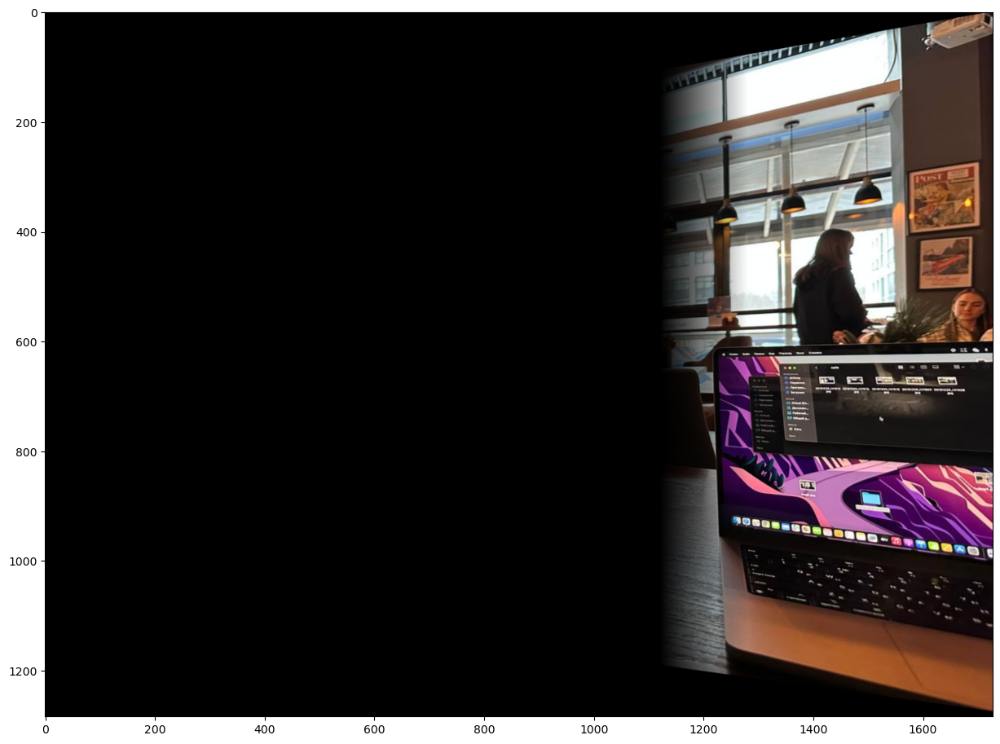

In [170]:
#display the rightside of pano before cropping
plt.figure(figsize=(15,15))
plt.imshow(convert_img(right_side))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


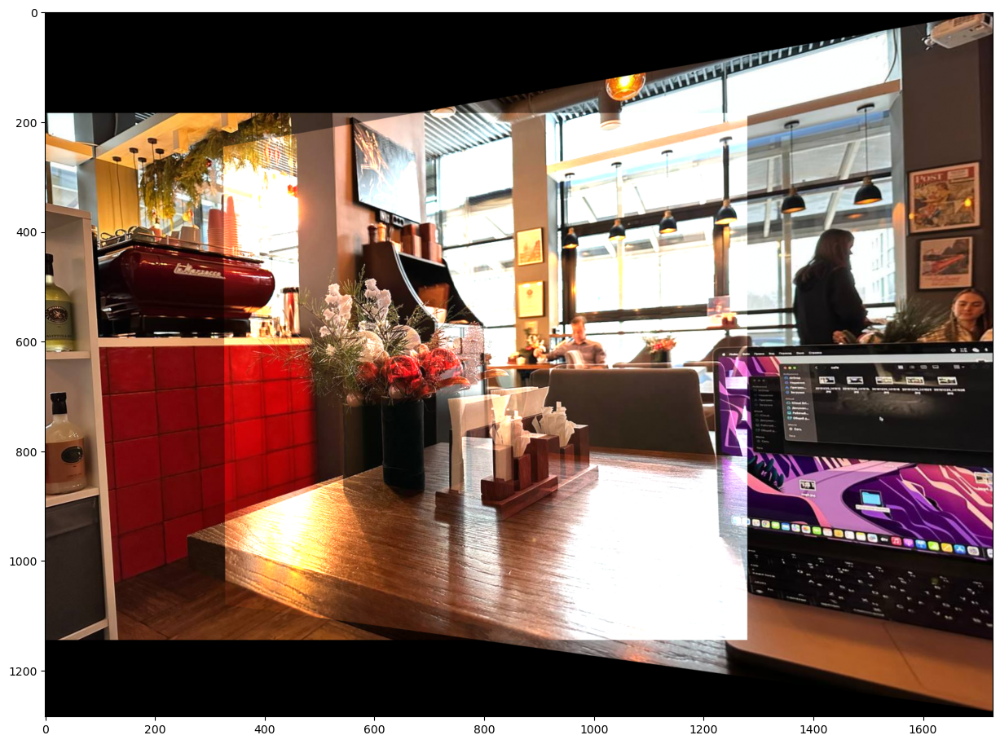

In [171]:
#display pano without cropping and blending
plt.figure(figsize=(15,15))
plt.imshow(convert_img(non_blend))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


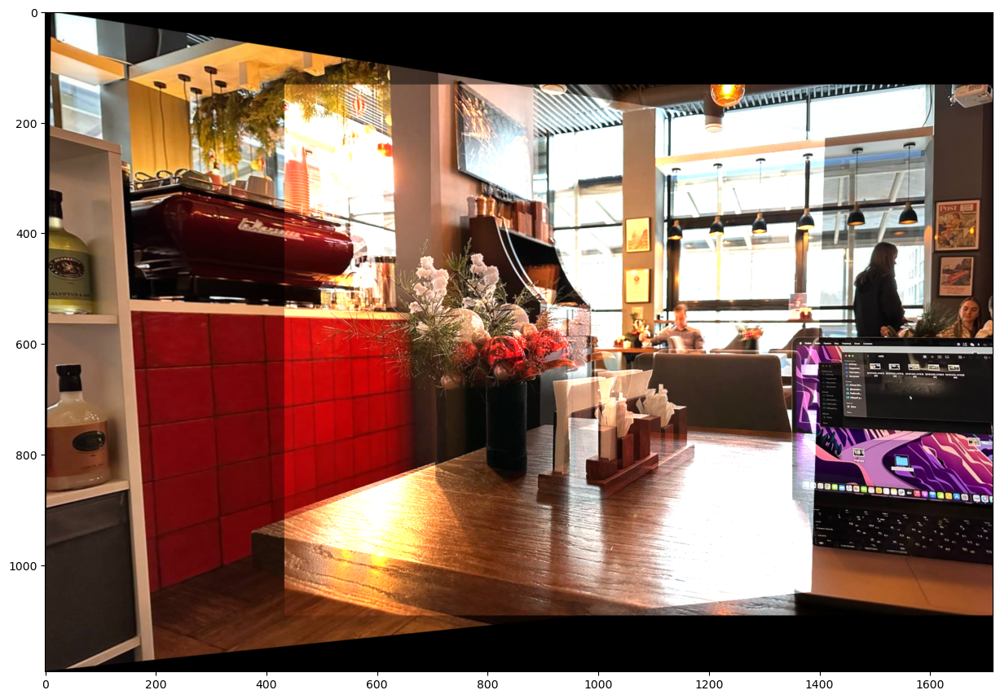

In [172]:
#if you choose list_images[1] as desination, the output look like this
_,non_blend2,_,_=warp_2_images(list_images[0],list_images[1])
plt.figure(figsize=(15,15))
plt.imshow(convert_img(non_blend2))

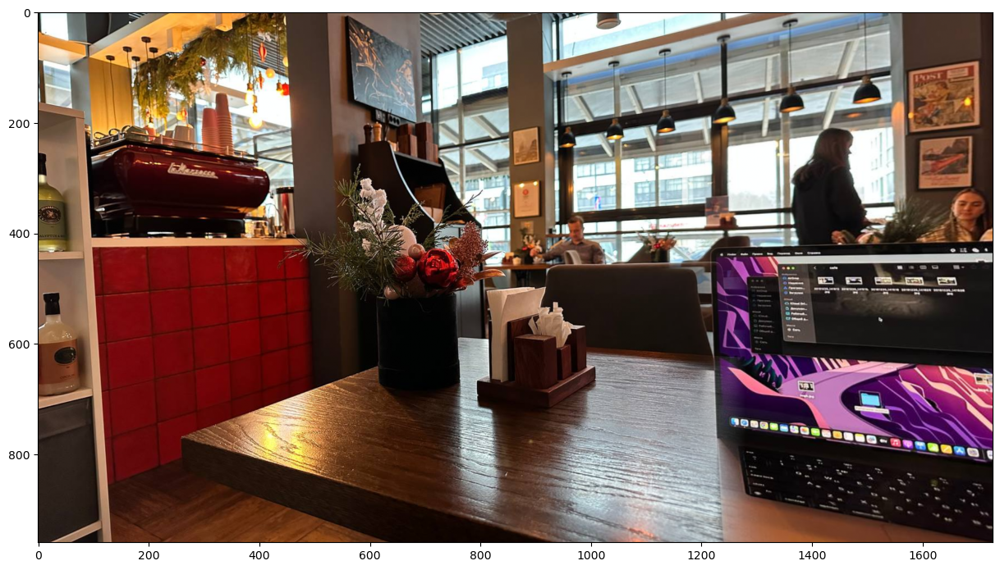

In [173]:
#pano after cropping and blending
plt.figure(figsize=(15,15))
plt.imshow(convert_img(panorama))

## ORB (Oriented FAST and Rotated BRIEF)

In [174]:
#extract keypoints and descriptors using sift
k0_,f0_=findAndDescribeFeatures(list_images[0], param = 'ORB')
k1_,f1_=findAndDescribeFeatures(list_images[1], param = 'ORB')

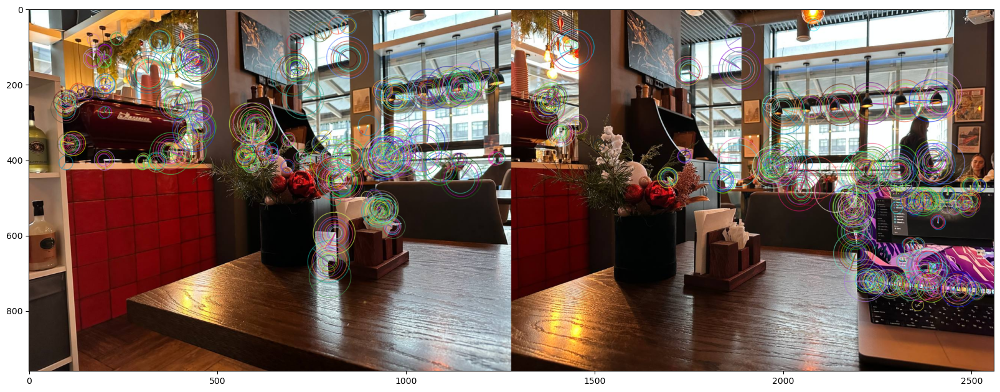

In [175]:
#draw keypoints
img0_kp=drawKeypoints(list_images[0].copy(),k0_)
img1_kp=drawKeypoints(list_images[1].copy(),k1_)

fig=plt.figure(figsize=(20.0, 16.0))
plt_img = np.concatenate((img0_kp, img1_kp), axis=1)
plt.imshow(plt_img)

In [176]:
#matching FLANN
mat_ = keypoints_matching(f0_,f1_,param='FL',param_2='ORB',ratio=0.8)

In [177]:
#find homography matrix and mask
H_, mat_mask_ = homography_matrix(list_images[0],list_images[1],param_2="ORB")

In [178]:
len(mat_)

78

In [179]:
len(mat_mask_)

24

In [180]:
def draw_matches_2(input_image, input_keypoints, final_image, final_keypoints, matches, matchesMask):
    return cv2.drawMatches(input_image, 
                           input_keypoints, 
                           final_image, 
                           final_keypoints, 
                           matches[:20], 
                           None, 
                           matchColor=(0, 255, 0), #set green color
                           singlePointColor=None,
                           matchesMask=matchesMask[:20], #draw only the first 100 matches
                           flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
                        )

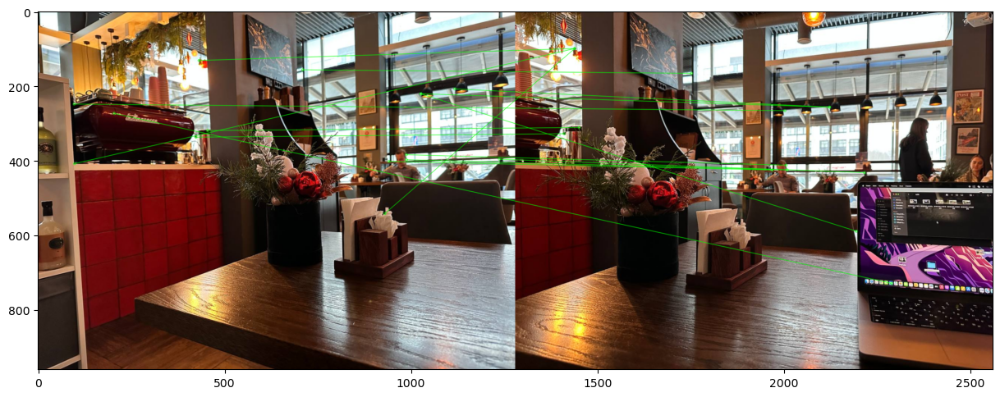

In [181]:
img=draw_matches_2(list_images[0],k0_,list_images[1],k1_,mat_,mat_mask_)
plt.figure(figsize=(15,15))
plt.imshow(img)

In [182]:
#wrap 2 image
#choose list_images[0] as desination
panorama,non_blend,left_side,right_side=warp_2_images(list_images[1],list_images[0],"ORB",True)

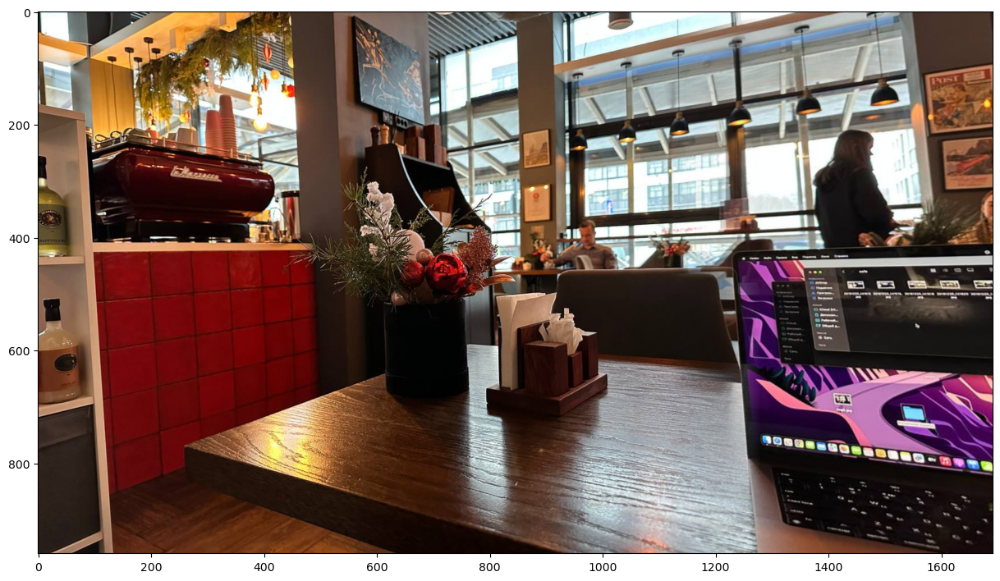

In [183]:
#pano after cropping and blending
plt.figure(figsize=(15,15))
plt.imshow(convert_img(panorama))

# MultiStitching for input images

In [185]:
 list_paths = sorted(glob.glob('img*.jpg')) # create list of images paths

In [186]:
 list_paths

['img1.jpg', 'img2.jpg', 'img3.jpg', 'img4.jpg', 'img5.jpg']

In [187]:
#load images
list_images = [plt.imread(path) for path in list_paths]

In [188]:
import os
def multiStitching(list_images, param_2 = "ORB"):
    """
    Stitch multiple images together assuming they are made in left-to-right order.

    Parameters:
    - list_images: The list containing images in left-to-right order.
    - smoothing_window: The value of the smooth transition after stitching.
    - output_folder: The folder containing the stitched image.

    Returns:
    - final_panorama: The stitched panorama image.
    """

    # Calculate the index of the middle image
    middle_index = int(len(list_images) / 2 + 0.5)

    # Divide the array into left and right sub-arrays
    left_images = list_images[:middle_index]
    right_images = list_images[len(list_images) - 1 : middle_index - 1 : -1]

    # Stitch images in the left sub-array
    while len(left_images) > 1:
        final_image = left_images.pop()
        input_image = left_images.pop()
        left_part, l_nonblend, l_leftside, l_rightside = warp_2_images(input_image, final_image, param_2,True)
        left_part = left_part.astype("uint8")
        left_images.append(left_part)

    # Stitch images in the right sub-array
    while len(right_images) > 1:
        final_image = right_images.pop()
        input_image = right_images.pop()
        right_part, r_nonblend, r_leftside, r_rightside = warp_2_images(input_image, final_image, param_2, True)
        right_part = right_part.astype("uint8")
        right_images.append(right_part)

    # Determine the final panorama based on the width of left and right parts
    if right_part.shape[1] >= left_part.shape[1]:
        final_panorama, nonblend, leftside, rightside = warp_2_images(left_part, right_part, param_2, True)
    else:
        final_panorama, nonblend, leftside, rightside = warp_2_images(right_part, left_part, param_2, True)
    

    return final_panorama


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


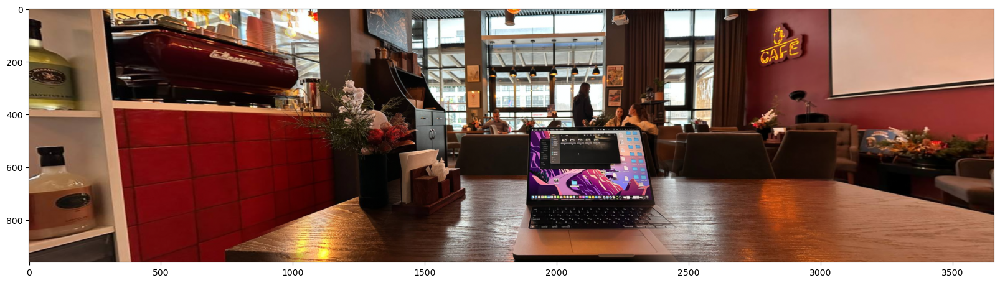

In [189]:
#multi stitching SIFT
panorama_1=multiStitching(list_images,param_2 = "SIFT")
plt.figure(figsize=(20,20))
plt.imshow(convert_img(panorama_1))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


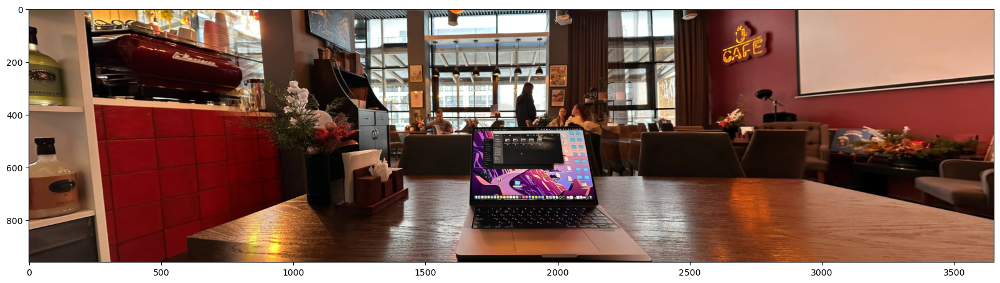

In [190]:
#multi stitching ORB
panorama_2=multiStitching(list_images,param_2 = "ORB")
plt.figure(figsize=(20,20))
plt.imshow(convert_img(panorama_2))

In [132]:
def convert_img_to_uint8(img):
    '''Convert image from range [0, 1] to [0, 255].'''
    img_uint8 = (img * 255).astype(np.uint8)
    return img_uint8

In [192]:
#download panorama
from PIL import Image

image = convert_img_to_uint8(convert_img(panorama_2))
# Convert the NumPy array to a PIL Image
image_pil = Image.fromarray(image)
# Save the image to a file 
image_pil.save('result.jpg')

## Comparison of SIFT and ORB
| Feature                  | SIFT                                      | ORB                                        |
|--------------------------|-------------------------------------------|--------------------------------------------|
| **Key Point Detection**  | SIFT detects key points based on scale and orientation in images. It is robust to scale changes and rotations. | ORB uses FAST (Features from Accelerated Segment Test) for key point detection, focusing on fast computation and rotational invariance. |
| **Descriptor**           | SIFT generates descriptors based on the local image gradients and orientations around key points. | ORB uses BRIEF (Binary Robust Independent Elementary Features) descriptors, consisting of binary strings generated by intensity comparisons. |
| **Scale Invariance**      | SIFT is scale-invariant, making it suitable for detecting features at different scales. | ORB is also scale-invariant, maintaining key points' robustness across different scales. |
| **Rotation Invariance**   | SIFT is rotation-invariant due to its consideration of key point orientation. | ORB achieves rotational invariance by assigning a unique orientation to each key point. |
| **Computational Speed**   | SIFT is computationally more intensive, especially in the generation of descriptors. | ORB is designed for faster computation, making it more efficient for real-time applications. |
| **Memory Usage**          | SIFT uses more memory due to its floating-point representation of descriptors. | ORB uses binary descriptors, reducing memory requirements and making it more memory-efficient. |
| **Robustness to Noise**   | SIFT is generally robust to noise in images. | ORB may be less robust to noise compared to SIFT. |
| **Usage**                | SIFT is suitable for applications where robust feature detection is critical, such as image stitching and object recognition. | ORB is well-suited for real-time applications and scenarios where computational efficiency is essential, such as in robotics and mobile applications. |


# NON-CV methods

### DISK

In [28]:
!pip install kornia
!pip install kornia-rs
!pip install kornia_moons --no-deps
!pip install opencv-python --upgrade

In [26]:
!pip install kornia

In [27]:
import kornia

ModuleNotFoundError: No module named 'kornia'

In [30]:
import cv2
import kornia as K
import kornia.feature as KF
import matplotlib.pyplot as plt
import numpy as np
import torch
from kornia.feature.adalam import AdalamFilter
from kornia_moons.viz import *

ModuleNotFoundError: No module named 'kornia'

### SuperGlue

In [1]:
!git clone https://github.com/magicleap/SuperGluePretrainedNetwork

Cloning into 'SuperGluePretrainedNetwork'...
remote: Enumerating objects: 182, done.
remote: Total 182 (delta 0), reused 0 (delta 0), pack-reused 182
Receiving objects: 100% (182/182), 118.85 MiB | 211.00 KiB/s, done.
Resolving deltas: 100% (52/52), done.


In [2]:
cd SuperGluePretrainedNetwork-master

/Users/iani.kuli/Desktop/ucafe/SuperGluePretrainedNetwork-master


In [8]:
!pip3 install numpy opencv-python torch matplotlib

In [15]:
!./match_pairs.py --input_dir ../ucafe/img --output_dir dump_demo_sequence --show_keypoints --viz

Namespace(cache=False, eval=False, fast_viz=False, force_cpu=False, input_dir='../ucafe/img', input_pairs='assets/scannet_sample_pairs_with_gt.txt', keypoint_threshold=0.005, match_threshold=0.2, max_keypoints=1024, max_length=-1, nms_radius=4, opencv_display=False, output_dir='dump_demo_sequence', resize=[640, 480], resize_float=False, show_keypoints=True, shuffle=False, sinkhorn_iterations=20, superglue='indoor', viz=True, viz_extension='png')
Will resize to 640x480 (WxH)
Running inference on device "cpu"
Loaded SuperPoint model
Loaded SuperGlue model ("indoor" weights)
Looking for data in directory "../ucafe/img"
Will write matches to directory "dump_demo_sequence"
Will write visualization images to directory "dump_demo_sequence"
[ WARN:0@0.529] global loadsave.cpp:248 findDecoder imread_('../ucafe/img/scene0711_00_frame-001680.jpg'): can't open/read file: check file path/integrity
[ WARN:0@0.529] global loadsave.cpp:248 findDecoder imread_('../ucafe/img/scene0711_00_frame-001995.jp

In [16]:
!./match_pairs.py --show_keypoints --viz

Namespace(cache=False, eval=False, fast_viz=False, force_cpu=False, input_dir='assets/scannet_sample_images/', input_pairs='assets/scannet_sample_pairs_with_gt.txt', keypoint_threshold=0.005, match_threshold=0.2, max_keypoints=1024, max_length=-1, nms_radius=4, opencv_display=False, output_dir='dump_match_pairs/', resize=[640, 480], resize_float=False, show_keypoints=True, shuffle=False, sinkhorn_iterations=20, superglue='indoor', viz=True, viz_extension='png')
Will resize to 640x480 (WxH)
Running inference on device "cpu"
Loaded SuperPoint model
Loaded SuperGlue model ("indoor" weights)
Looking for data in directory "assets/scannet_sample_images"
Will write matches to directory "dump_match_pairs"
Will write visualization images to directory "dump_match_pairs"
[W NNPACK.cpp:53] Could not initialize NNPACK! Reason: Unsupported hardware.
[Finished pair     0 of     1] load_image=0.020 matcher=5.465 viz_match=0.534 total=6.019 sec {0.2 FPS} 


In [10]:
!./match_pairs.py --help

usage: match_pairs.py [-h] [--input_pairs INPUT_PAIRS] [--input_dir INPUT_DIR]
                      [--output_dir OUTPUT_DIR] [--max_length MAX_LENGTH]
                      [--resize RESIZE [RESIZE ...]] [--resize_float]
                      [--superglue {outdoor,indoor}]
                      [--max_keypoints MAX_KEYPOINTS]
                      [--keypoint_threshold KEYPOINT_THRESHOLD]
                      [--nms_radius NMS_RADIUS]
                      [--sinkhorn_iterations SINKHORN_ITERATIONS]
                      [--match_threshold MATCH_THRESHOLD] [--viz] [--eval]
                      [--fast_viz] [--cache] [--show_keypoints]
                      [--viz_extension {png,pdf}] [--opencv_display]
                      [--shuffle] [--force_cpu]

Image pair matching and pose evaluation with SuperGlue

optional arguments:
  -h, --help            show this help message and exit
  --input_pairs INPUT_PAIRS
                        Path to the list of image pairs (default:
         

### DISK

In [224]:
#rm -rf disk

In [232]:
#cd ucafe

/Users/iani.kuli/Desktop/ucafe


In [233]:
#!git clone https://github.com/cvlab-epfl/disk

Cloning into 'disk'...
remote: Enumerating objects: 237, done.
remote: Counting objects: 100% (53/53), done.
remote: Compressing objects: 100% (9/9), done.
remote: Total 237 (delta 45), reused 44 (delta 44), pack-reused 184
Receiving objects: 100% (237/237), 9.65 MiB | 245.00 KiB/s, done.
Resolving deltas: 100% (118/118), done.


In [278]:
#cd disk

/Users/iani.kuli/Desktop/ucafe/disk


In [318]:
#!pip install --user -r requirements.txt

Processing ./submodules/torch-localize
  Preparing metadata (setup.py) ... done
Processing ./submodules/torch-dimcheck
  Preparing metadata (setup.py) ... done
Processing ./submodules/unets
  Preparing metadata (setup.py) ... done


  Created wheel for torch-localize: filename=torch_localize-0.1.0-py3-none-any.whl size=2652 sha256=178346b18d990d55c497d63b0c0616470de19135bc42448eeadd394f0800b32a
  Stored in directory: /Users/iani.kuli/Library/Caches/pip/wheels/4a/c7/a0/1ef113477bb48e1abd873e6d2e54a183191ba03803e04a7287
  Created wheel for torch-dimcheck: filename=torch_dimcheck-0.0.1-py3-none-any.whl size=3460 sha256=54fc70d4ab1c9013d44035c3dc31dc18d289eb0feac0232620cb8502b7d4aba3
  Stored in directory: /Users/iani.kuli/Library/Caches/pip/wheels/20/87/72/4382b0e9000b4bc5710043eacb8c529eb18b0e03010c83dc3c
  Created wheel for unets: filename=unets-0.1.0-py3-none-any.whl size=5184 sha256=2084fa743effe22fefe64538263014ed902815b9e16be3148416b7897ba683a1
  Stored in directory: /private/var/folders/wd/jmytmn4x6757rdkn_gmbdqc40000gn/T/pip-ephem-wheel-cache-69a_tijm/wheels/3c/e5/93/c49c6577b10a60a81b71b437b2c861c3fb104ed8c81806d7b6
Successfully built torch-localize torch-dimcheck unets
  Attempting uninstall: unets
    Foun

In [319]:
#pwd

'/Users/iani.kuli/Desktop/ucafe/disk'

In [ ]:
#!python3 detect.py h5_artifacts_destination img

In [ ]:
#!python3 match.py h5_artifacts_destination